In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn.metrics as skm
import sklearn.model_selection as skms
import sklearn.preprocessing as skp
import sklearn.ensemble as ske

In [2]:
music_data = pd.read_csv('/home/akshita/python-ws/Data/features_30_sec.csv')
print("Dataset has", music_data.shape)
music_data.head()

Dataset has (1000, 60)


,filename,length,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,...,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var,label
0,blues.00000.wav,661794,0.350088,0.088757,0.130228,0.002827,1784.165850,129774.064525,2002.449060,85882.761315,...,52.420910,-1.690215,36.524071,-0.408979,41.597103,-2.303523,55.062923,1.221291,46.936035,blues
1,blues.00001.wav,661794,0.340914,0.094980,0.095948,0.002373,1530.176679,375850.073649,2039.036516,213843.755497,...,55.356403,-0.731125,60.314529,0.295073,48.120598,-0.283518,51.106190,0.531217,45.786282,blues
2,blues.00002.wav,661794,0.363637,0.085275,0.175570,0.002746,1552.811865,156467.643368,1747.702312,76254.192257,...,40.598766,-7.729093,47.639427,-1.816407,52.382141,-3.439720,46.639660,-2.231258,30.573025,blues
3,blues.00003.wav,661794,0.404785,0.093999,0.141093,0.006346,1070.106615,184355.942417,1596.412872,166441.494769,...,44.427753,-3.319597,50.206673,0.636965,37.319130,-0.619121,37.259739,-3.407448,31.949339,blues
4,blues.00004.wav,661794,0.308526,0.087841,0.091529,0.002303,1835.004266,343399.939274,1748.172116,88445.209036,...,86.099236,-5.454034,75.269707,-0.916874,53.613918,-4.404827,62.910812,-11.703234,55.195160,blues


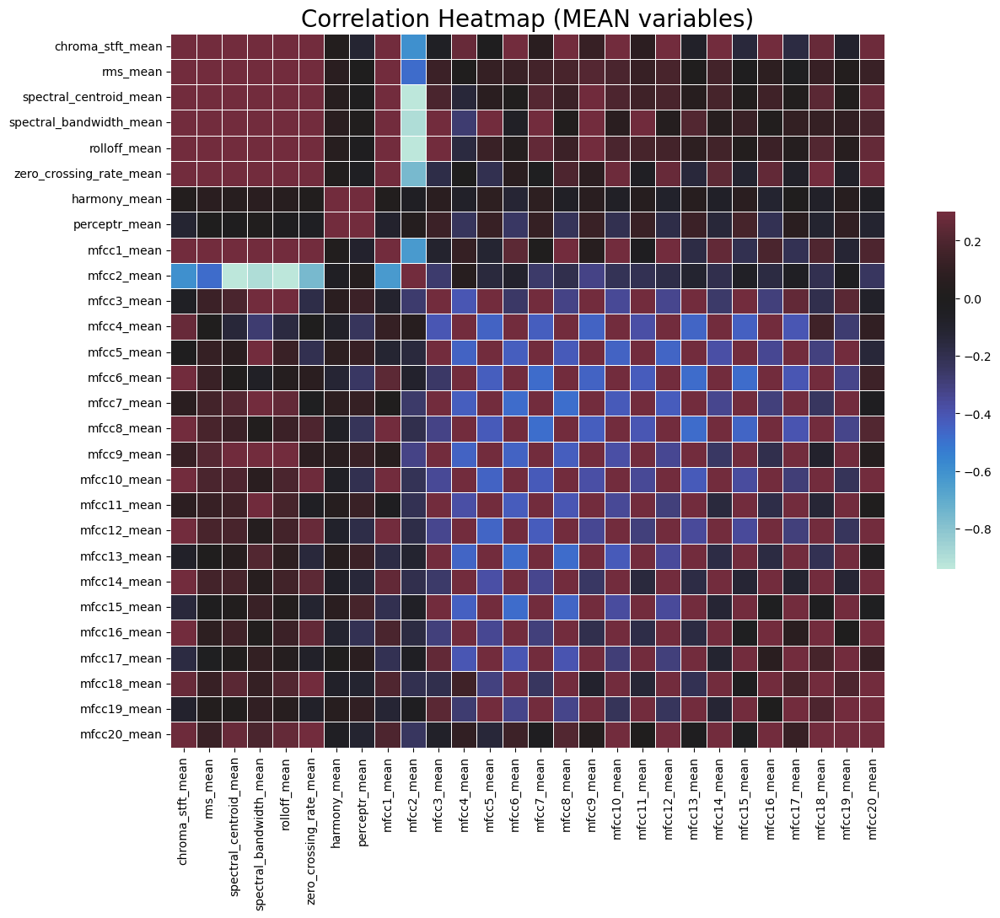

In [3]:
# Computing the  Correlation Matrix using only the features that have 'mean' in their name.
mean_cols = [col for col in music_data.columns if 'mean' in col]
corr = music_data[mean_cols].corr()

#the matplotlib figure
f, ax = plt.subplots(figsize=(16, 11));
sns.heatmap(corr, vmax=.3, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5})

plt.title('Correlation Heatmap (MEAN variables)', fontsize = 20)
plt.xticks(fontsize = 10)
plt.yticks(fontsize = 10);
plt.savefig("Corr_Heatmap.png")

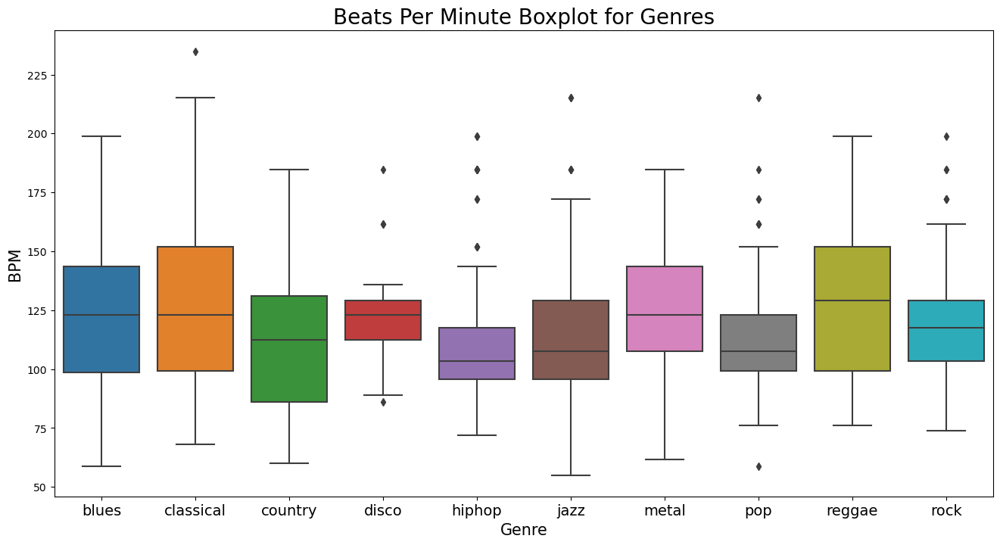

In [4]:
# A box plot to show the distribution of music pieces in different genres in different tempo/beats per minute values.
x = music_data[["label", "tempo"]]

fig, ax = plt.subplots(figsize=(16, 8));
sns.boxplot(x = "label", y = "tempo", data = x);

plt.title('Beats Per Minute Boxplot for Genres', fontsize = 20)
plt.xticks(fontsize = 14)
plt.yticks(fontsize = 10);
plt.xlabel("Genre", fontsize = 15)
plt.ylabel("BPM", fontsize = 15)
plt.savefig("BPM_Boxplot.png")

In [5]:
#Checking for null values in the data. 
print("Columns with null values are",list(music_data.columns[music_data.isnull().any()]))
#Since there are no null values in any of the columns, there is no need to create dummy values.

Columns with null values are []


In [6]:
# map labels to index
label_index = dict()
index_label = dict()
for i, x in enumerate(music_data.label.unique()):
    label_index[x] = i
    index_label[i] = x
print(label_index)
print(index_label)

{'blues': 0, 'classical': 1, 'country': 2, 'disco': 3, 'hiphop': 4, 'jazz': 5, 'metal': 6, 'pop': 7, 'reggae': 8, 'rock': 9}
{0: 'blues', 1: 'classical', 2: 'country', 3: 'disco', 4: 'hiphop', 5: 'jazz', 6: 'metal', 7: 'pop', 8: 'reggae', 9: 'rock'}


In [7]:
# update labels in df to index
music_data.label = [label_index[l] for l in music_data.label]

In [8]:
#Splitting the data into training testing and validation sets
data_shuffle = music_data.sample(frac=1, random_state=12).reset_index(drop=True) #shuffling the data
# remove columns that have no impact on the prediction
data_shuffle.drop(['filename', 'length'], axis=1, inplace=True)
data_y = data_shuffle.pop('label')
data_X = data_shuffle


# split original dataset into train and test
X_train, data_test_valid_X, y_train, data_test_valid_y = skms.train_test_split(data_X, data_y, train_size=0.7, random_state=12, stratify=data_y)
#split test dataset into validation and test
X_validation, X_test, y_validation, y_test = skms.train_test_split(data_test_valid_X, data_test_valid_y, train_size=0.66, random_state=12, stratify=data_test_valid_y)
#stratify - all the sets will have an equal proportion of genres

#Validating the data splits
print(f"Train set has {X_train.shape[0]} records out of {len(data_shuffle)} which is {round(X_train.shape[0]/len(data_shuffle)*100)}% of the data.")
print(f"Validation set has {X_validation.shape[0]} records out of {len(data_shuffle)} which is {round(X_validation.shape[0]/len(data_shuffle)*100)}% of the data.")
print(f"Test set has {X_test.shape[0]} records out of {len(data_shuffle)} which is {round(X_test.shape[0]/len(data_shuffle)*100)}% of the data.")

Train set has 700 records out of 1000 which is 70% of the data.
Validation set has 198 records out of 1000 which is 20% of the data.
Test set has 102 records out of 1000 which is 10% of the data.


In [9]:
#scaling the features. This will ensure that features with larger values do not affect the prediction
#disproportionately compared to the smaller values
scaler = skp.StandardScaler()
X_train = pd.DataFrame(scaler.fit_transform(X_train), columns=X_train.columns)
X_validation = pd.DataFrame(scaler.transform(X_validation), columns=X_train.columns)
X_test = pd.DataFrame(scaler.transform(X_test), columns=X_train.columns)

In [10]:
X_train[:5] # To show the changes in the values of the features.

,chroma_stft_mean,chroma_stft_var,rms_mean,rms_var,spectral_centroid_mean,spectral_centroid_var,spectral_bandwidth_mean,spectral_bandwidth_var,rolloff_mean,rolloff_var,...,mfcc16_mean,mfcc16_var,mfcc17_mean,mfcc17_var,mfcc18_mean,mfcc18_var,mfcc19_mean,mfcc19_var,mfcc20_mean,mfcc20_var
0,0.057247,-0.790500,0.342682,-0.514693,0.083436,-0.592513,-0.178699,-0.835022,0.016406,-0.635393,...,0.768181,-0.544900,-1.372360,-1.048256,0.276826,-0.949620,-0.146467,-0.923327,0.130373,-0.942447
1,-0.734659,-0.209415,0.770486,0.124682,-0.327375,-0.484939,-0.391665,-0.521084,-0.323645,-0.518111,...,0.634784,0.175229,-1.305191,0.214344,0.602786,-0.276234,-1.546473,-0.229145,-1.060775,-0.662192
2,1.752669,-2.038986,-0.276637,-0.612828,0.665096,-0.729102,0.134450,-1.085243,0.471748,-0.917944,...,1.516314,-0.606788,-0.782357,-1.167385,1.330279,-0.895360,-0.525507,-0.933720,1.079782,-0.934836
3,-0.155343,0.714559,0.888791,0.447331,0.119819,-0.229398,0.649484,0.142947,0.417062,0.103119,...,0.606047,-0.005242,0.817352,-0.270879,-0.046698,0.271937,1.137747,0.360000,0.721559,-0.430315
4,-1.295979,0.759244,-0.484529,-0.460918,-1.353810,-0.505271,-1.472509,0.047439,-1.351078,-0.405064,...,-2.314510,-0.105180,-0.114584,-0.087874,-1.576440,1.304544,0.348574,2.445483,0.007638,1.687644


In [11]:
def results(model, X, validation=False):
    y_true = y_train
    if validation:
        X = X_validation[X.columns]
        y_true = y_validation
    y_prediction = model.predict(X)
    confusion_matrix = skm.confusion_matrix(y_true, y_prediction)
    cm_display = skm.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix)
    cm_display.plot()
    plt.show()
    print(skm.classification_report(y_true, y_prediction, digits=3))
    print(skm.precision_recall_fscore_support(y_true, y_prediction, average="macro"))
    print("=====================================================")

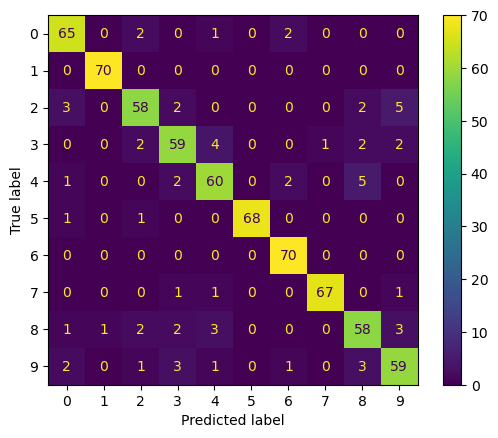

              precision    recall  f1-score   support

           0      0.890     0.929     0.909        70
           1      0.986     1.000     0.993        70
           2      0.879     0.829     0.853        70
           3      0.855     0.843     0.849        70
           4      0.857     0.857     0.857        70
           5      1.000     0.971     0.986        70
           6      0.933     1.000     0.966        70
           7      0.985     0.957     0.971        70
           8      0.829     0.829     0.829        70
           9      0.843     0.843     0.843        70

    accuracy                          0.906       700
   macro avg      0.906     0.906     0.905       700
weighted avg      0.906     0.906     0.905       700

(0.9057385673969673, 0.9057142857142859, 0.9054471159370465, None)


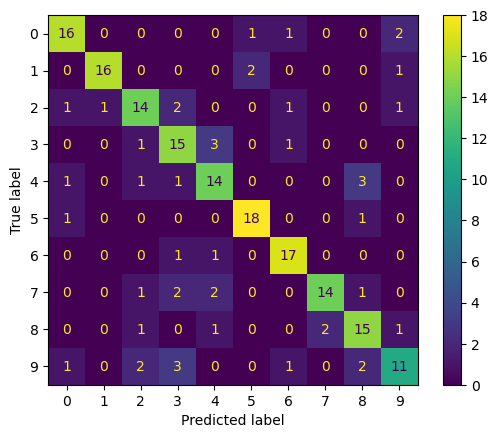

              precision    recall  f1-score   support

           0      0.800     0.800     0.800        20
           1      0.941     0.842     0.889        19
           2      0.700     0.700     0.700        20
           3      0.625     0.750     0.682        20
           4      0.667     0.700     0.683        20
           5      0.857     0.900     0.878        20
           6      0.810     0.895     0.850        19
           7      0.875     0.700     0.778        20
           8      0.682     0.750     0.714        20
           9      0.688     0.550     0.611        20

    accuracy                          0.758       198
   macro avg      0.764     0.759     0.758       198
weighted avg      0.763     0.758     0.757       198

(0.7643827985739751, 0.7586842105263158, 0.7584857283637773, None)


In [19]:
#Feature importance using logistic regression
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression(max_iter=1999)
lr.fit(X_train, y_train)
results(lr, X_train)
results(lr, X_train, validation=True)

In [20]:
import eli5
from eli5.sklearn import PermutationImportance

In [21]:
perm = PermutationImportance(lr, random_state=12).fit(X_validation, y_validation, n_iter=10)
print("Feature Importances using Permutation Importance from the eli5 library")
eli5.show_weights(perm, feature_names = X_train.columns.tolist())

Feature Importances using Permutation Importance from the eli5 library


Weight,Feature
0.0869 ± 0.0196,mfcc20_var
0.0869 ± 0.0346,chroma_stft_mean
0.0808 ± 0.0361,perceptr_var
0.0778 ± 0.0450,rms_var
0.0707 ± 0.0338,zero_crossing_rate_mean
0.0707 ± 0.0332,mfcc1_mean
0.0707 ± 0.0212,mfcc3_mean
0.0707 ± 0.0447,mfcc4_mean
0.0657 ± 0.0383,mfcc9_mean
0.0646 ± 0.0322,mfcc12_mean


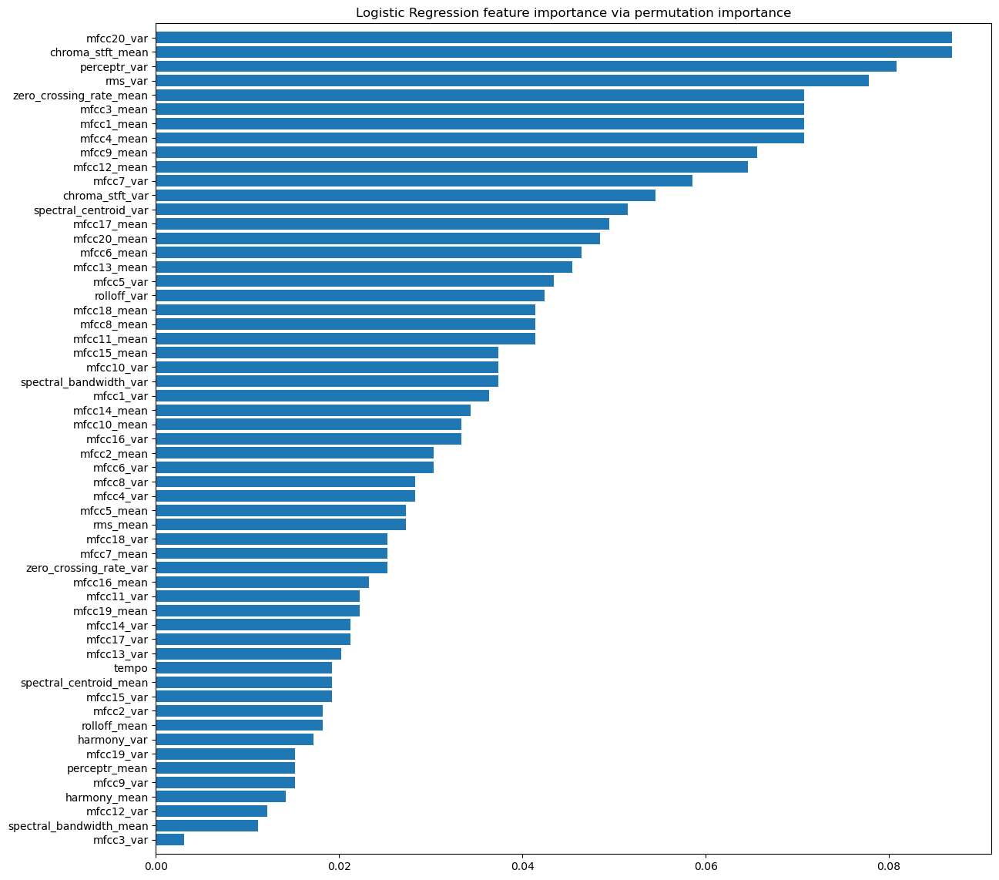

In [22]:
# plot the permutation importances
perm_indices = np.argsort(perm.feature_importances_)[::-1]
perm_features = [X_validation.columns.tolist()[xx] for xx in perm_indices]
plt.figure(figsize=(14, 14))
plt.title("Logistic Regression feature importance via permutation importance")
plt.barh(range(X_validation.shape[1]), perm.feature_importances_[perm_indices])
plt.yticks(range(X_validation.shape[1]), perm_features)
plt.ylim([X_validation.shape[1], -1])
plt.savefig("perm_importance.png")
plt.show()

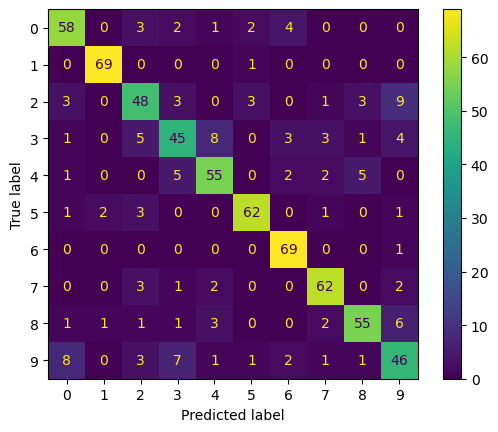

              precision    recall  f1-score   support

           0      0.795     0.829     0.811        70
           1      0.958     0.986     0.972        70
           2      0.727     0.686     0.706        70
           3      0.703     0.643     0.672        70
           4      0.786     0.786     0.786        70
           5      0.899     0.886     0.892        70
           6      0.863     0.986     0.920        70
           7      0.861     0.886     0.873        70
           8      0.846     0.786     0.815        70
           9      0.667     0.657     0.662        70

    accuracy                          0.813       700
   macro avg      0.810     0.813     0.811       700
weighted avg      0.810     0.813     0.811       700

(0.8103948242834857, 0.8128571428571428, 0.810826931277145, None)


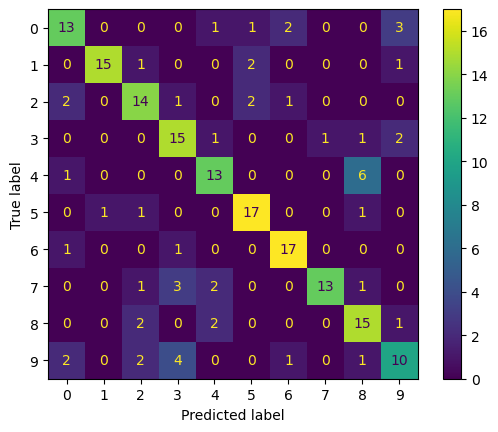

              precision    recall  f1-score   support

           0      0.684     0.650     0.667        20
           1      0.938     0.789     0.857        19
           2      0.667     0.700     0.683        20
           3      0.625     0.750     0.682        20
           4      0.684     0.650     0.667        20
           5      0.773     0.850     0.810        20
           6      0.810     0.895     0.850        19
           7      0.929     0.650     0.765        20
           8      0.600     0.750     0.667        20
           9      0.588     0.500     0.541        20

    accuracy                          0.717       198
   macro avg      0.730     0.718     0.719       198
weighted avg      0.728     0.717     0.717       198

(0.7296645524238403, 0.718421052631579, 0.7186658100646623, None)


In [25]:
# build model using perm selected top 30 features
lr_mif = LogisticRegression(max_iter=1999)
X_train_mif = X_train[perm_features[:30]]
lr_mif.fit(X_train_mif,y_train)
results(lr_mif, X_train_mif)
results(lr_mif, X_train_mif, validation=True)

In [26]:
# Tuning hyperparameters of the logistic regression model using grid_search. 
solvers = ['newton-cg', 'lbfgs', 'liblinear']
penalty =['l2']
c_values = [100, 10, 1.0, 0.1, 0.01]

param_grid = {'solver': solvers, 'penalty':penalty, 'C': c_values}
cv = skms.RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
lr_grid_search = skms.GridSearchCV(lr_mif, param_grid, n_jobs=-1, cv=cv, scoring='accuracy', error_score=0)
lr_grid_search.fit(X_train_mif, y_train)
print(lr_grid_search.best_params_)
print(lr_grid_search.best_estimator_)

{'C': 1.0, 'penalty': 'l2', 'solver': 'newton-cg'}
LogisticRegression(max_iter=1999, solver='newton-cg')


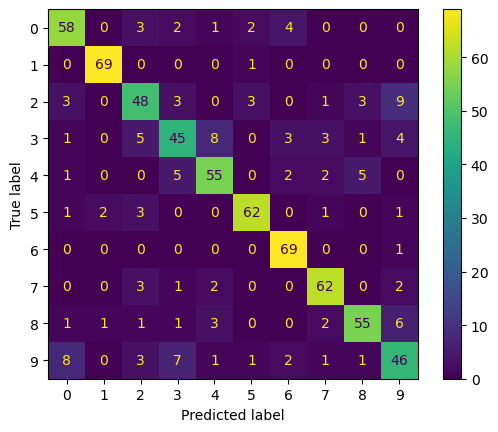

              precision    recall  f1-score   support

           0      0.795     0.829     0.811        70
           1      0.958     0.986     0.972        70
           2      0.727     0.686     0.706        70
           3      0.703     0.643     0.672        70
           4      0.786     0.786     0.786        70
           5      0.899     0.886     0.892        70
           6      0.863     0.986     0.920        70
           7      0.861     0.886     0.873        70
           8      0.846     0.786     0.815        70
           9      0.667     0.657     0.662        70

    accuracy                          0.813       700
   macro avg      0.810     0.813     0.811       700
weighted avg      0.810     0.813     0.811       700

(0.8103948242834857, 0.8128571428571428, 0.810826931277145, None)


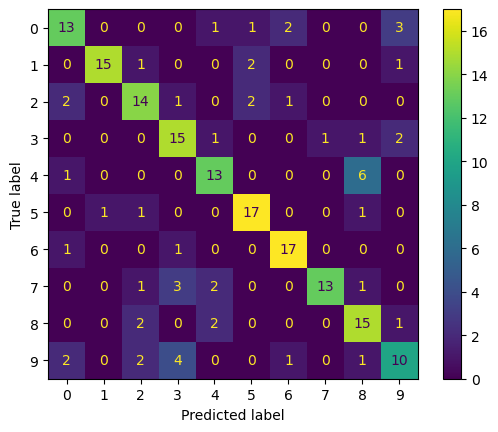

              precision    recall  f1-score   support

           0      0.684     0.650     0.667        20
           1      0.938     0.789     0.857        19
           2      0.667     0.700     0.683        20
           3      0.625     0.750     0.682        20
           4      0.684     0.650     0.667        20
           5      0.773     0.850     0.810        20
           6      0.810     0.895     0.850        19
           7      0.929     0.650     0.765        20
           8      0.600     0.750     0.667        20
           9      0.588     0.500     0.541        20

    accuracy                          0.717       198
   macro avg      0.730     0.718     0.719       198
weighted avg      0.728     0.717     0.717       198

(0.7296645524238403, 0.718421052631579, 0.7186658100646623, None)


In [27]:
results(lr_grid_search.best_estimator_, X_train_mif)
results(lr_grid_search.best_estimator_, X_train_mif, validation=True)

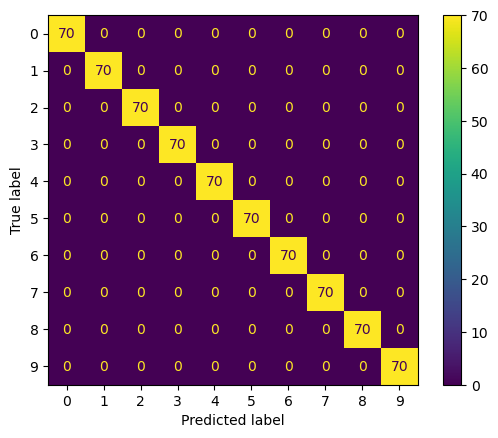

              precision    recall  f1-score   support

           0      1.000     1.000     1.000        70
           1      1.000     1.000     1.000        70
           2      1.000     1.000     1.000        70
           3      1.000     1.000     1.000        70
           4      1.000     1.000     1.000        70
           5      1.000     1.000     1.000        70
           6      1.000     1.000     1.000        70
           7      1.000     1.000     1.000        70
           8      1.000     1.000     1.000        70
           9      1.000     1.000     1.000        70

    accuracy                          1.000       700
   macro avg      1.000     1.000     1.000       700
weighted avg      1.000     1.000     1.000       700

(1.0, 1.0, 1.0, None)


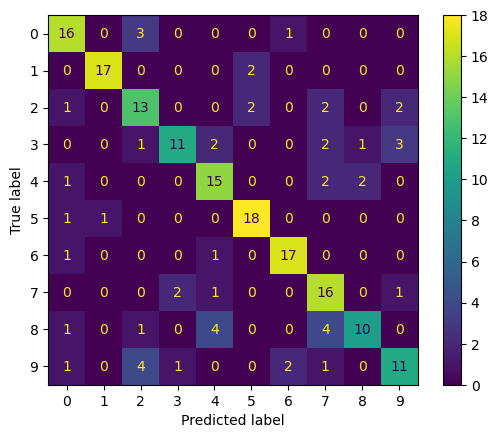

              precision    recall  f1-score   support

           0      0.727     0.800     0.762        20
           1      0.944     0.895     0.919        19
           2      0.591     0.650     0.619        20
           3      0.786     0.550     0.647        20
           4      0.652     0.750     0.698        20
           5      0.818     0.900     0.857        20
           6      0.850     0.895     0.872        19
           7      0.593     0.800     0.681        20
           8      0.769     0.500     0.606        20
           9      0.647     0.550     0.595        20

    accuracy                          0.727       198
   macro avg      0.738     0.729     0.726       198
weighted avg      0.736     0.727     0.724       198

(0.7377578464918619, 0.7289473684210527, 0.725504853542808, None)


In [28]:
# Fitting the dataset with the 30 most important features to a random forest model
rfc = ske.RandomForestClassifier(random_state=12, n_jobs=-1)
rfc.fit(X_train_mif, y_train)
results(rfc, X_train_mif)
results(rfc, X_train_mif, validation=True)

In [29]:
# Tuning hyperparameters of the random forest model using grid_search.
n_estimators = [100, 1000]
max_features = ['sqrt', 'log2']
param_grid_rf = {'n_estimators': n_estimators, 'max_features': max_features}
cv = skms.RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
rf_grid_search = skms.GridSearchCV(estimator=rfc, param_grid=param_grid_rf, cv=cv, scoring='accuracy',error_score=0)
rf_grid_search.fit(X_train_mif, y_train)
print(rf_grid_search.best_params_)
print(rf_grid_search.best_estimator_)

{'max_features': 'sqrt', 'n_estimators': 1000}
RandomForestClassifier(n_estimators=1000, n_jobs=-1, random_state=12)


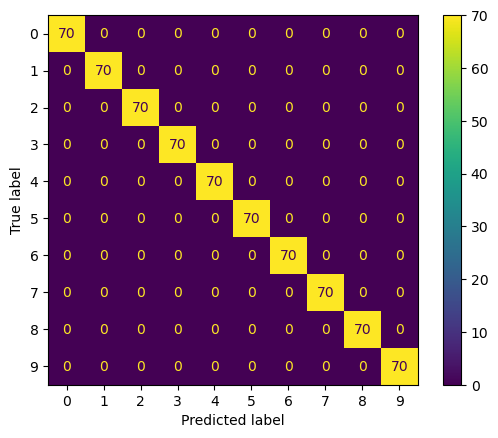

              precision    recall  f1-score   support

           0      1.000     1.000     1.000        70
           1      1.000     1.000     1.000        70
           2      1.000     1.000     1.000        70
           3      1.000     1.000     1.000        70
           4      1.000     1.000     1.000        70
           5      1.000     1.000     1.000        70
           6      1.000     1.000     1.000        70
           7      1.000     1.000     1.000        70
           8      1.000     1.000     1.000        70
           9      1.000     1.000     1.000        70

    accuracy                          1.000       700
   macro avg      1.000     1.000     1.000       700
weighted avg      1.000     1.000     1.000       700

(1.0, 1.0, 1.0, None)


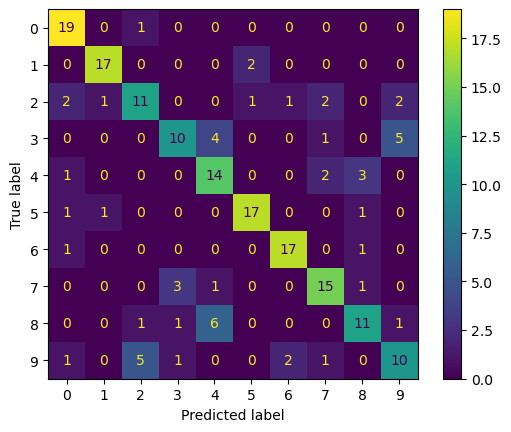

              precision    recall  f1-score   support

           0      0.760     0.950     0.844        20
           1      0.895     0.895     0.895        19
           2      0.611     0.550     0.579        20
           3      0.667     0.500     0.571        20
           4      0.560     0.700     0.622        20
           5      0.850     0.850     0.850        20
           6      0.850     0.895     0.872        19
           7      0.714     0.750     0.732        20
           8      0.647     0.550     0.595        20
           9      0.556     0.500     0.526        20

    accuracy                          0.712       198
   macro avg      0.711     0.714     0.709       198
weighted avg      0.709     0.712     0.707       198

(0.7109414713253723, 0.7139473684210527, 0.7086192021557876, None)


In [30]:
results(rf_grid_search.best_estimator_, X_train_mif)
results(rf_grid_search.best_estimator_, X_train_mif, validation=True)

In [31]:


# Modifying the results function to return a confusion matrix for the test set
def test_results(model, X, validation=False):
    y_true = y_train
    if validation:
        X = X_test[X.columns]
        y_true = y_test
    y_prediction = model.predict(X)
    confusion_matrix = skm.confusion_matrix(y_true, y_prediction)
    cm_display = skm.ConfusionMatrixDisplay(confusion_matrix = confusion_matrix)
    cm_display.plot()
    plt.show()
    print(skm.classification_report(y_true, y_prediction, digits=3))
    print(skm.precision_recall_fscore_support(y_true, y_prediction, average="macro"))
    print("=====================================================")



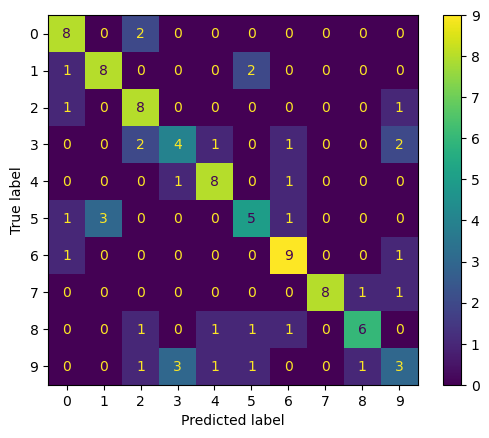

              precision    recall  f1-score   support

           0      0.667     0.800     0.727        10
           1      0.727     0.727     0.727        11
           2      0.571     0.800     0.667        10
           3      0.500     0.400     0.444        10
           4      0.727     0.800     0.762        10
           5      0.556     0.500     0.526        10
           6      0.692     0.818     0.750        11
           7      1.000     0.800     0.889        10
           8      0.750     0.600     0.667        10
           9      0.375     0.300     0.333        10

    accuracy                          0.657       102
   macro avg      0.657     0.655     0.649       102
weighted avg      0.658     0.657     0.651       102

(0.6565503940503941, 0.6545454545454545, 0.64927660059239, None)


In [32]:


# Calculating the accuracy, precision, recall, f1-score, and sensitivity of the random forest model.
test_results(rf_grid_search.best_estimator_, X_train_mif, validation=True)



In [34]:
import librosa, librosa.display
import IPython.display as ipd

plt.rcParams['figure.figsize'] = (10, 3)

# from sklearn.metrics.pairwise import cosine_similarity
from scipy.spatial.distance import cdist

In [35]:
features = music_data.iloc[:,2:-1]
features_scaled=skp.scale(features)

features.describe().T

,count,mean,std,min,25%,50%,75%,max
chroma_stft_mean,1000.0,3.786817e-01,8.170489e-02,1.719392e-01,0.319562,3.831479e-01,4.359417e-01,6.636847e-01
chroma_stft_var,1000.0,8.633982e-02,7.735298e-03,4.455525e-02,0.082298,8.661463e-02,9.125551e-02,1.081115e-01
rms_mean,1000.0,1.309297e-01,6.568311e-02,5.276444e-03,0.086657,1.224431e-01,1.756822e-01,3.979734e-01
rms_var,1000.0,3.051399e-03,3.634500e-03,4.294372e-06,0.000942,1.816440e-03,3.577055e-03,2.767948e-02
spectral_centroid_mean,1000.0,2.201781e+03,7.159606e+02,5.700404e+02,1627.697311,2.209263e+03,2.691295e+03,4.435244e+03
spectral_centroid_var,1000.0,4.696916e+05,4.008995e+05,7.911251e+03,184350.530174,3.384862e+05,6.121479e+05,3.036843e+06
spectral_bandwidth_mean,1000.0,2.242541e+03,5.263165e+02,8.980662e+02,1907.240605,2.221393e+03,2.578470e+03,3.509646e+03
spectral_bandwidth_var,1000.0,1.370792e+05,9.645567e+04,1.078719e+04,67376.554428,1.119775e+05,1.823716e+05,6.947848e+05
rolloff_mean,1000.0,4.571549e+03,1.574792e+03,7.491406e+02,3380.069642,4.658524e+03,5.533810e+03,8.677673e+03
rolloff_var,1000.0,1.844345e+06,1.425085e+06,1.468612e+04,772731.230777,1.476115e+06,2.555262e+06,8.660900e+06


In [38]:
distances = cdist(features_scaled, features_scaled, 'cosine') #cosine distance

dist_df = pd.DataFrame(distances)
dist_df = dist_df.set_index(music_data.filename)
dist_df.columns = music_data.filename
dist_df

filename,blues.00000.wav,blues.00001.wav,blues.00002.wav,blues.00003.wav,blues.00004.wav,blues.00005.wav,blues.00006.wav,blues.00007.wav,blues.00008.wav,blues.00009.wav,...,rock.00090.wav,rock.00091.wav,rock.00092.wav,rock.00093.wav,rock.00094.wav,rock.00095.wav,rock.00096.wav,rock.00097.wav,rock.00098.wav,rock.00099.wav
filename,,,,,,,,,,,,,,,,,,,,,
blues.00000.wav,0.000000,0.950769,0.410382,0.715138,0.974439,1.346688,1.219483,1.167626,0.358123,1.097889,...,1.082829,0.453831,0.421442,0.337410,0.428371,0.389058,0.359165,0.503706,7.150424e-01,0.695902
blues.00001.wav,0.950769,0.000000,1.096834,0.479097,0.919251,0.692144,0.681714,0.584742,0.879351,0.595832,...,1.098111,1.325126,1.370792,1.191698,1.330834,1.077301,1.222119,1.302573,5.004378e-01,0.688277
blues.00002.wav,0.410382,1.096834,0.000000,0.789589,0.599734,1.082019,1.028061,0.895554,0.531887,1.132532,...,1.032408,0.438926,0.409221,0.416707,0.485463,0.504293,0.433163,0.410017,7.836224e-01,0.678931
blues.00003.wav,0.715138,0.479097,0.789589,0.000000,0.873563,0.865204,0.699254,0.675434,0.647242,0.704816,...,1.320107,1.206516,1.151132,0.958014,1.172515,1.000287,0.979485,1.107821,4.977214e-01,0.816790
blues.00004.wav,0.974439,0.919251,0.599734,0.873563,0.000000,0.443934,0.517805,0.376545,0.970297,0.528343,...,0.912395,0.982634,0.861965,0.895316,1.034594,0.936546,0.936454,0.827056,8.468076e-01,0.938215
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
rock.00095.wav,0.389058,1.077301,0.504293,1.000287,0.936546,1.231012,1.251086,1.180628,0.380550,1.258421,...,0.976074,0.156273,0.148274,0.139406,0.148544,0.000000,0.097936,0.134759,6.501304e-01,0.477517
rock.00096.wav,0.359165,1.222119,0.433163,0.979485,0.936454,1.272209,1.291506,1.256171,0.387830,1.304636,...,1.033826,0.128774,0.117175,0.119638,0.136938,0.097936,0.000000,0.097929,6.621657e-01,0.527669
rock.00097.wav,0.503706,1.302573,0.410017,1.107821,0.827056,1.175960,1.203014,1.155732,0.538680,1.330066,...,1.008336,0.085830,0.073442,0.102346,0.121149,0.134759,0.097929,0.000000,7.128432e-01,0.584827


In [39]:
def songs_similarity(song_name, features, metric='cosine'):
    distances = cdist(features, features, metric=metric)
    dist_df = pd.DataFrame(distances)
    dist_df = dist_df.set_index(music_data.filename)
    dist_df.columns = music_data.filename
    series = dist_df[song_name].sort_values(ascending = True)
    series = series.drop(song_name)
    return series

In [40]:
audio_path = '/home/akshita/python-ws/Data/genres_original/'
song_name = 'classical.00077.wav'
ipd.Audio(audio_path+song_name.split('.')[0]+'/'+song_name)



In [41]:
sim_songs = songs_similarity(song_name, features_scaled)
sim_songs

filename
classical.00079.wav    0.163032
classical.00065.wav    0.192554
classical.00035.wav    0.232339
classical.00066.wav    0.266772
classical.00058.wav    0.272568
                         ...   
metal.00053.wav        1.609674
metal.00051.wav        1.623948
metal.00087.wav        1.627464
disco.00003.wav        1.628881
metal.00078.wav        1.676451
Name: classical.00077.wav, Length: 999, dtype: float64

In [42]:
print('- 3 most similar songs: -')
for i in range(3):
    sim_song = sim_songs.index[i]
    print(sim_song)
    ipd.display(ipd.Audio(audio_path+sim_song.split('.')[0]+'/'+ sim_song))

- 3 most similar songs: -
classical.00079.wav


classical.00065.wav


classical.00035.wav


In [43]:
print('- 3 most different songs: -')
for i in range(1,4):
    sim_song = sim_songs.index[-i]
    print(sim_song)
    ipd.display(ipd.Audio(audio_path+sim_song.split('.')[0]+'/'+ sim_song))

- 3 most different songs: -
metal.00078.wav


disco.00003.wav


metal.00087.wav


In [44]:
song_name = 'pop.00030.wav'
ipd.Audio(audio_path+song_name.split('.')[0]+'/'+song_name)

In [48]:
sim_songs = songs_similarity(song_name, features_scaled)
sim_songs

filename
pop.00031.wav        0.009124
pop.00020.wav        0.115402
pop.00035.wav        0.139532
pop.00038.wav        0.206301
pop.00021.wav        0.209238
                       ...   
country.00087.wav    1.548983
rock.00011.wav       1.559930
country.00050.wav    1.644732
country.00086.wav    1.653294
rock.00099.wav       1.677412
Name: pop.00030.wav, Length: 999, dtype: float64

In [46]:
print('- 3 most similar songs: -')
for i in range(3):
    sim_song = sim_songs.index[i]
    print(sim_song)
    ipd.display(ipd.Audio(audio_path+sim_song.split('.')[0]+'/'+ sim_song))

- 3 most similar songs: -
pop.00031.wav


pop.00020.wav


pop.00035.wav


In [47]:
print('- 3 most different songs: -')
for i in range(1,4):
    sim_song = sim_songs.index[-i]
    print(sim_song)
    ipd.display(ipd.Audio(audio_path+sim_song.split('.')[0]+'/'+ sim_song))


- 3 most different songs: -
rock.00099.wav


country.00086.wav


country.00050.wav
